In [3]:
import os
# import pandas as pd
from pathlib import Path
# from tqdm import tqdm
# import matplotlib.pyplot as plt
# import seaborn as sns
from typing import List, Dict


datapath = Path('/home/jseia/Desktop/thesis/data/')
csv_path = Path('/home/jseia/Desktop/thesis/code/stroke-seg/data/dataset.csv')
base_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2')
os.environ['nnUNet_raw'] = str(base_path/'nnUNet_raw')
os.environ['nnUNet_preprocessed'] = str(base_path/'preprocessed')
os.environ['nnUNet_results'] = str(base_path/'nnUNet_trained_models')

# from ssl.model_interpreter import EmpeddingProjector, DimReductor, AttrGenerator
import ssl.plots as ssl_plots

import sys ; sys.path.insert(0, '/home/jseia/Desktop/thesis/code/stroke-seg')
from dataset.dataset import StrokeDataset
import sys ; sys.path.remove('/home/jseia/Desktop/thesis/code/stroke-seg')

dataset = StrokeDataset(
    datapath=datapath,
    datasets=['apis', 'aisd', 'tum'],#, 'tbi'], 
    data_csv_path=csv_path,
    cases_to_exclude=[],
    pathology=['ais'],
    modalities=['ncct', 'ncct-tilt', 'msk', 'msk-tilt'],
    partitions=['train'],
    standard=['gold', 'silver', '-'],
    filter_discard=True
)

base_cfg_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/DeSD/cfg_files/ssl_pretrain/')
base_experiments_path = Path('/home/jseia/Desktop/thesis/experiments/')

In [4]:
dataset.df.dataset_name.value_counts()

aisd    273
tum     111
apis     30
Name: dataset_name, dtype: int64

In [6]:
(273+111+30) / 111

3.72972972972973

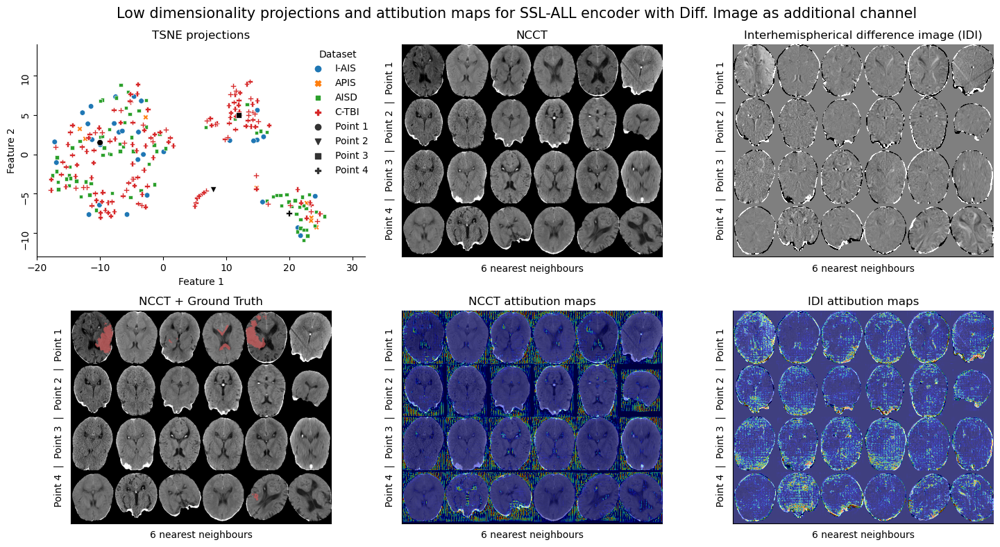

In [2]:
%matplotlib inline
exps_cfgs = [
    {'data': 'all_ncct', 'exp': '002', 'context': 'diff', 'encoder_name': 'SSL-ALL encoder with Diff. Image as additional channel',
     'centers': {'tsne': [[-10, 1.5], [8, -4.5], [12, 5], [20, -7.5]]}},
    # {'data': 'non_tbi', 'exp': '004', 'context': 'diff',
    #  'centers': {'tsne': [[-10, -5], [0,-12], [7, -12], [4, 13]]}},
    # {'data': 'tbi', 'exp': '002', 'context': 'diff',
    #  'centers': {'tsne': [[-16, 5], [-10, 0], [0, 10], [5, -10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method_diff(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=2, slice_criteria='middle'
)

In [2]:
# import torch
# from collections import OrderedDict
# from pathlib import Path

# base_path = Path('/home/jseia/Desktop/thesis/experiments/nnunet_encoder/non_tbi/')
# src_path = base_path / 'checkpoint_best_Dataset050_AIS_FS_r0.pth'
# # base_path = Path('/home/jseia/Desktop/thesis/experiments/nnunet_encoder/tum/')
# # src_path = base_path / 'checkpoint_best_Dataset046_AIS_FS_r0.pth'

# ref_path = Path('/home/jseia/Desktop/thesis/experiments/all_ncct/001/checkpoint.pth')
# src = torch.load(src_path)
# ssl_checkpoint = torch.load(ref_path)
# ssl_encoder = {'network_weights': {}}

# for k, v in src['network_weights'].items():
#     if ("encoder" in k) and ("decoder" not in k):
#         k = str(k).replace('encoder', 'backbone.net')
#         ssl_checkpoint['teacher'][k] = v

# for k, v in src['network_weights'].items():
#     if 'encoder' in k:
#         ssl_encoder['network_weights'][k] = v

# ssl_checkpoint['teacher'] = OrderedDict(ssl_checkpoint['teacher'])
# ssl_encoder['network_weights'] = OrderedDict(ssl_encoder['network_weights'])
# torch.save(ssl_checkpoint, base_path/'checkpoint.pth')
# torch.save(ssl_encoder, base_path/'ssl_checkpoint.pth')

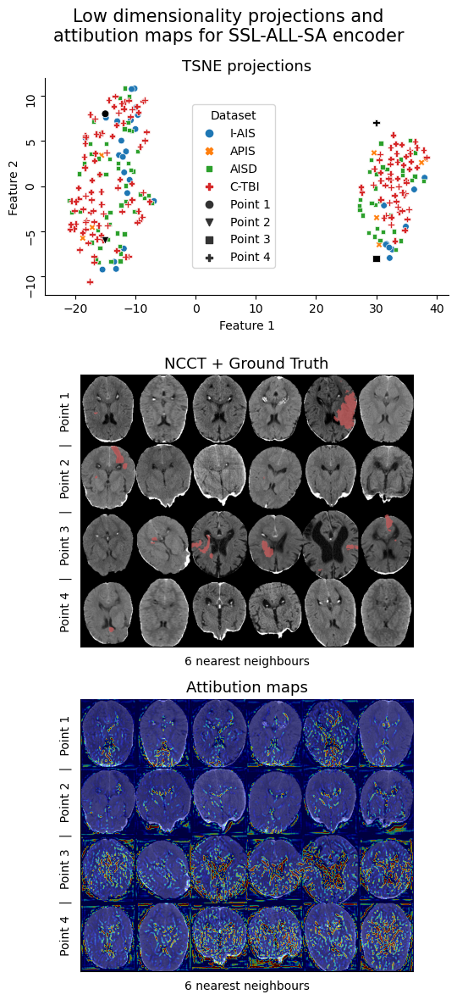

In [3]:
%matplotlib inline
exps_cfgs = [
    # {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-', 'encoder_name': 'FS-STKi encoder',
    #  'centers': {'tsne': [[-6, -5], [-5, 12], [5, -5], [9, 8]]}},
    # {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-', 'encoder_name': 'FS-STKp encoder',
    #  'centers': {'tsne': [[-10, 0], [-10, 10], [3, 12], [10, -3]]}},
    {'data': 'all_ncct', 'exp': '004', 'context': 'sym', 'encoder_name': 'SSL-ALL-SA encoder',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method_sr(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', slice_criteria='middle'
)

In [2]:
import captum.attr as attr

base_cfg_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/DeSD/cfg_files/ssl_pretrain/')
base_experiments_path = Path('/home/jseia/Desktop/thesis/experiments/')

def get_saliency_maps(exps_cfgs: List[Dict], dataset, force: bool = True):
    for exp_cfg in exps_cfgs:
        cfg_filename = f'config_{exp_cfg["data"]}_{exp_cfg["exp"]}.yml'
        exp_path = base_experiments_path / exp_cfg['data'] / exp_cfg["exp"]
        out_path = exp_path / 'attribution'
        if not out_path.exists() or force:
            saliency_gen = AttrGenerator(
                cfg_file_path=base_cfg_path/exp_cfg['data']/cfg_filename,
                chckpt_file_path=exp_path/'checkpoint.pth',
                device='cuda', method=attr.IntegratedGradients,
                layer=False, suffix='ig')
            subjects = dataset.df.loc[dataset.df.dataset_name == 'tum', 'subject'].unique().tolist()
            print(subjects)
            saliency_gen(subjects, save_saliency=True, out_path=out_path)
exps_cfgs = [
    # {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-'}, # FS TUM (Dataset046_AIS_FS_r0)
    # {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-'}, # FS NON-TBI (Dataset043_AIS_FS_r0)
]
# get_saliency_maps(exps_cfgs, dataset)

In [ ]:
# def get_projections(exps_cfgs: List[Dict], dataset, force: bool = True):
#     for exp_cfg in tqdm(exps_cfgs):
#         cfg_filename = f'config_{exp_cfg["data"]}_{exp_cfg["exp"]}.yml'
#         exp_path = base_experiments_path / exp_cfg['data'] / exp_cfg["exp"]
#         csv_path = exp_path/'complete_vol_embeddings.csv'
#         if not csv_path.exists() or force:
#             embedding_projector = EmpeddingProjector(
#                 cfg_file_path=base_cfg_path/exp_cfg['data']/cfg_filename,
#                 chckpt_file_path=exp_path/'checkpoint.pth',
#                 device='cuda'
#             )
#             embeddings = embedding_projector(dataset=dataset)
#             embeddings['dataset'] = exp_cfg["data"]
#             embeddings['context'] = exp_cfg["context"]
#             embeddings.to_csv(csv_path)
#         else:
#             embeddings = pd.read_csv(csv_path, index_col=0)

#         projections_csv_path = exp_path/'complete_vol_reductions.csv'
#         if not projections_csv_path.exists() or force:
#             projections = pd.DataFrame()
#             for method in ['pca', 'tsne', 'umap']:
#                 method_kwargs = {'n_components': 2, 'random_state': 0}
#                 if method == 'tsne':
#                     method_kwargs.update({'learning_rate': 'auto', 'init': 'pca'})
#                 reductor = DimReductor(method=method, method_kwargs=method_kwargs)
#                 method_projections = reductor(embeddings)
#                 meta_cols = [col for col in method_projections.columns if 'feat' not in col]
#                 projections[meta_cols] = method_projections[meta_cols].values
#                 projections[[f'{method}0', f'{method}1']] = method_projections[['feat0', 'feat1']].values
#             projections['dataset'] = exp_cfg["data"]
#             projections['context'] = exp_cfg["context"]
#             projections.to_csv(projections_csv_path)
#         else:
#             projections = pd.read_csv(projections_csv_path, index_col=0)

# exps_cfgs = [
#     # {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-'}, # FS TUM (Dataset046_AIS_FS_r0)
#     {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-'}, # FS NON-TBI (Dataset043_AIS_FS_r0)
# ]

# get_projections(exps_cfgs, dataset)

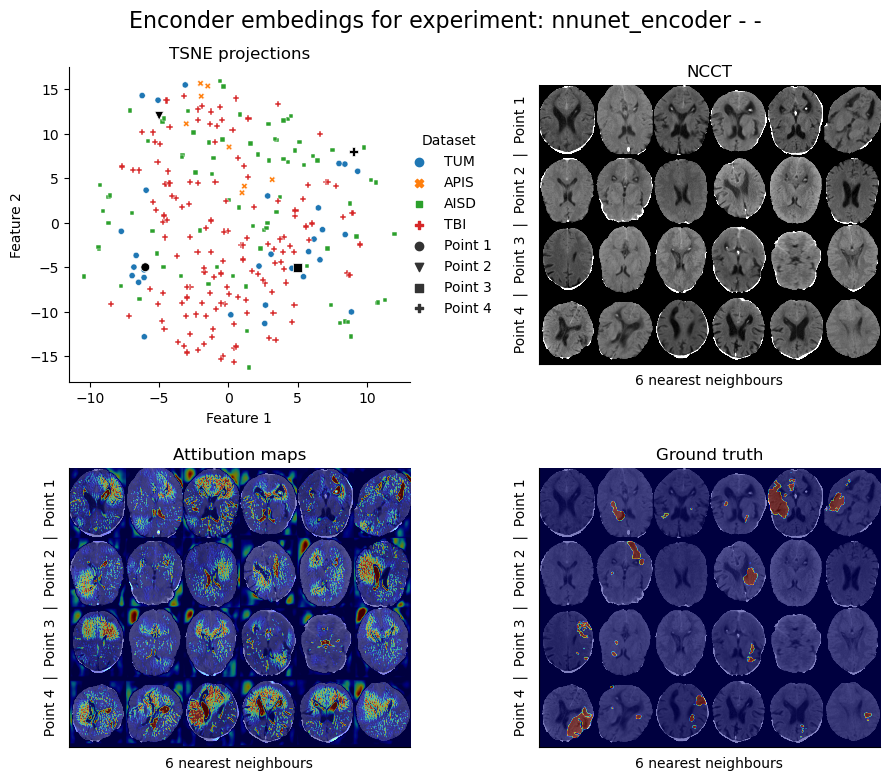

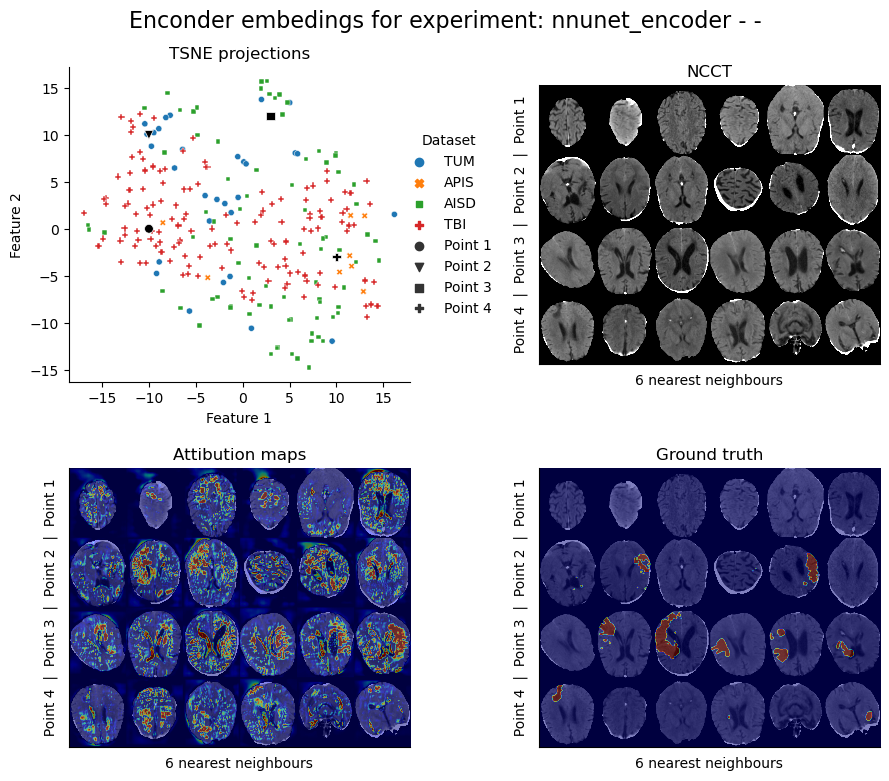

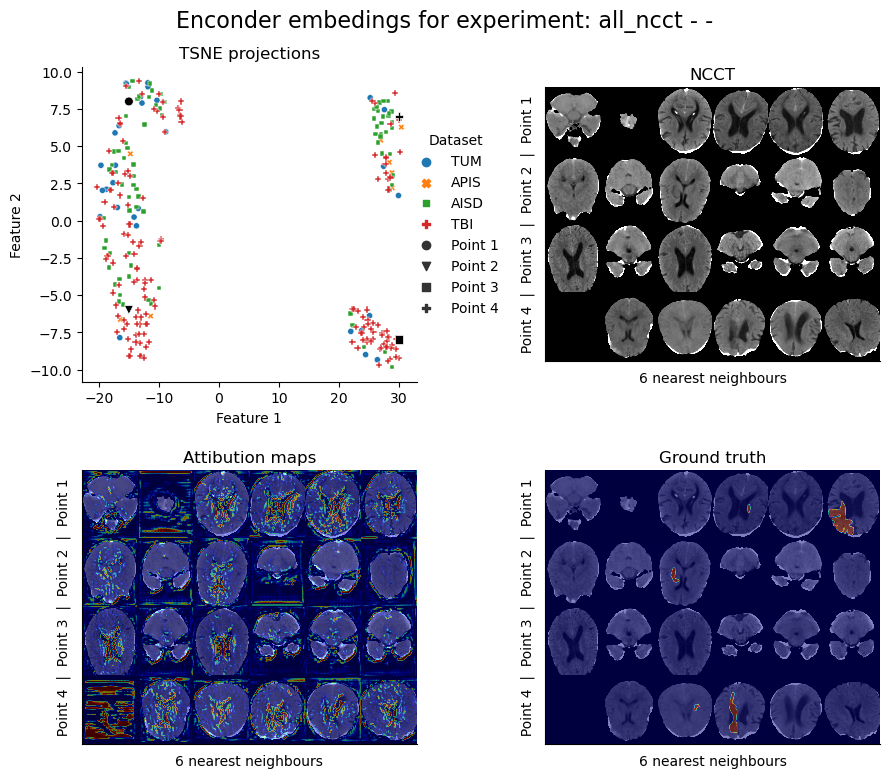

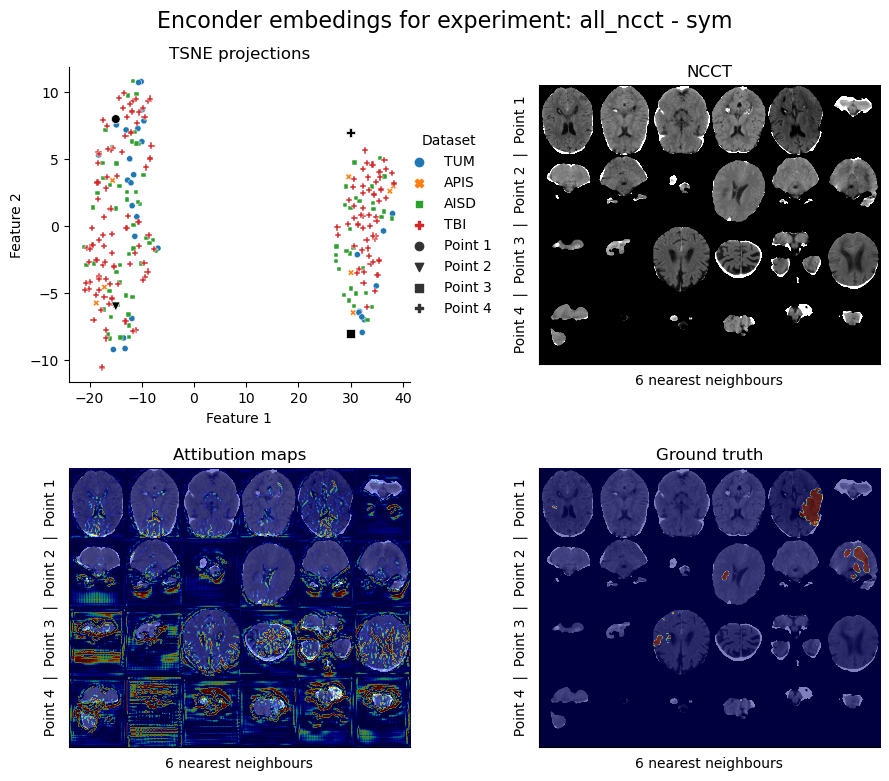

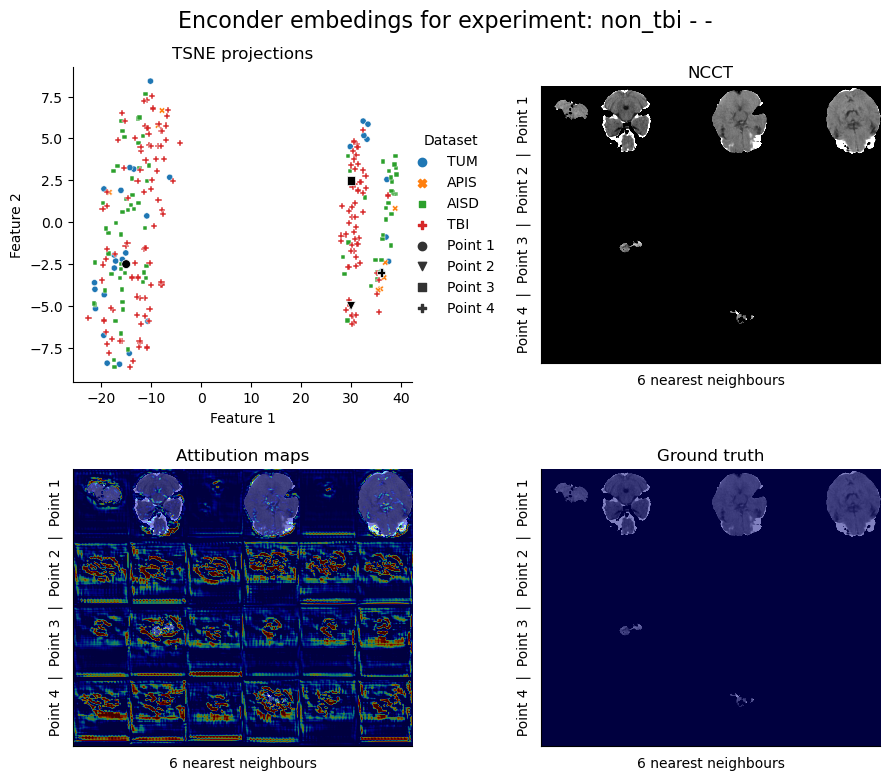

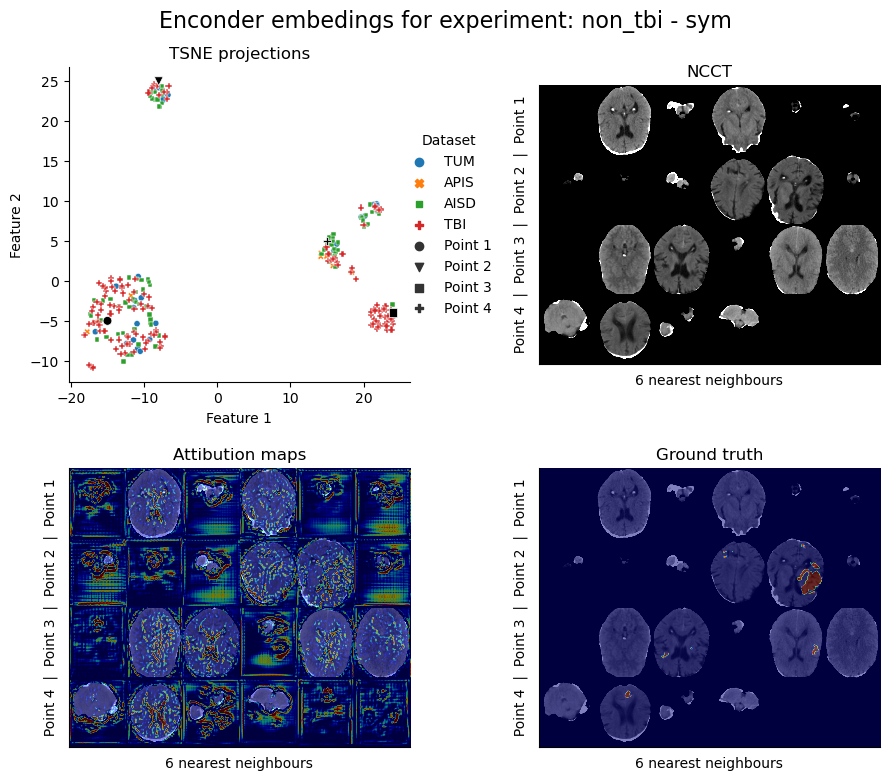

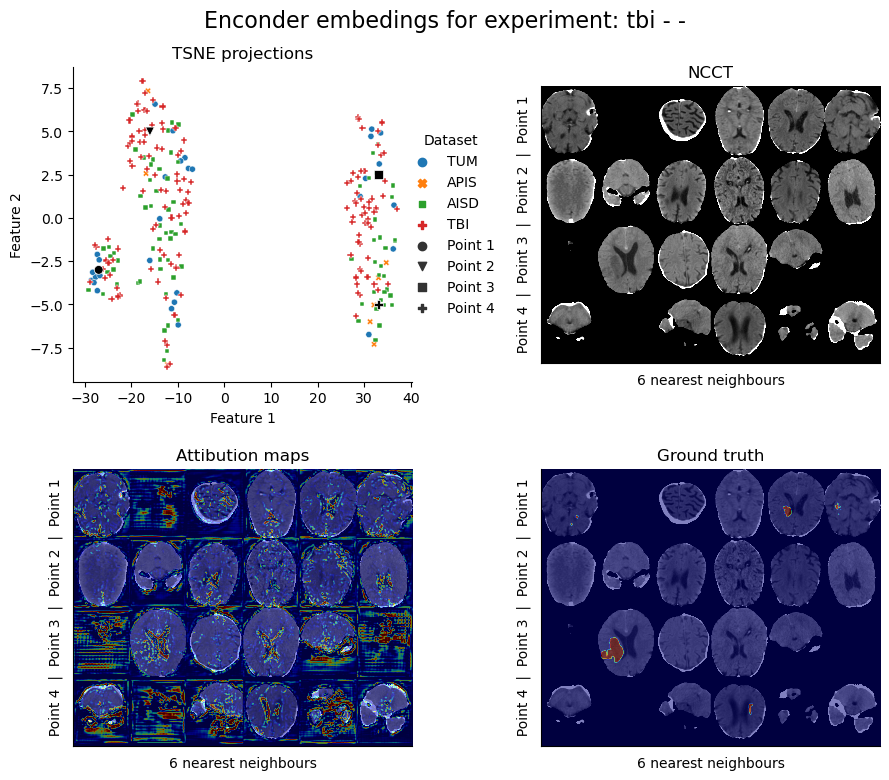

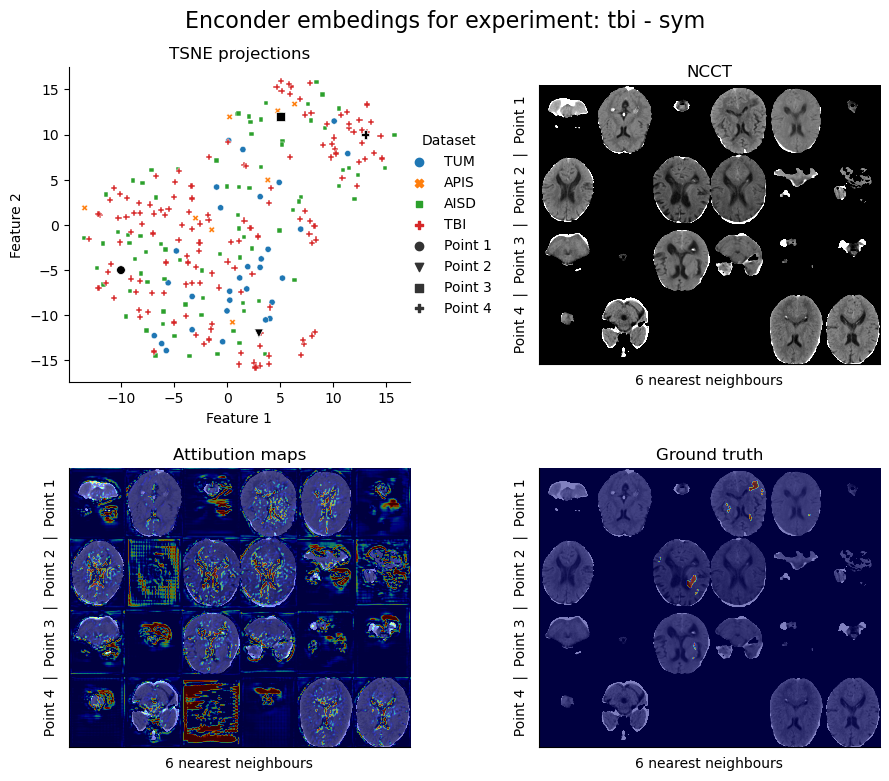

In [5]:
%matplotlib inline
exps_cfgs = [
    {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-',
     'centers': {'tsne': [[-6, -5], [-5, 12], [5, -5], [9, 8]]}},
    {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-',
     'centers': {'tsne': [[-10, 0], [-10, 10], [3, 12], [10, -3]]}},
    {'data': 'all_ncct', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'all_ncct', 'exp': '004', 'context': 'sym',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'non_tbi', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, -2.5], [30, -5], [30, 2.5],[36, -3]]}},
    {'data': 'non_tbi', 'exp': '003', 'context': 'sym',
     'centers': {'tsne': [[-15, -5], [-8,25], [24, -4], [15, 5]]}},
    {'data': 'tbi', 'exp': '000', 'context': '-',
     'centers': {'tsne': [[-27, -3], [-16, 5], [33, 2.5], [33, -5]]}},
    {'data': 'tbi', 'exp': '001', 'context': 'sym',
     'centers': {'tsne': [[-10, -5], [3, -12], [5, 12], [13, 10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=1, slice_criteria='attribute'
)

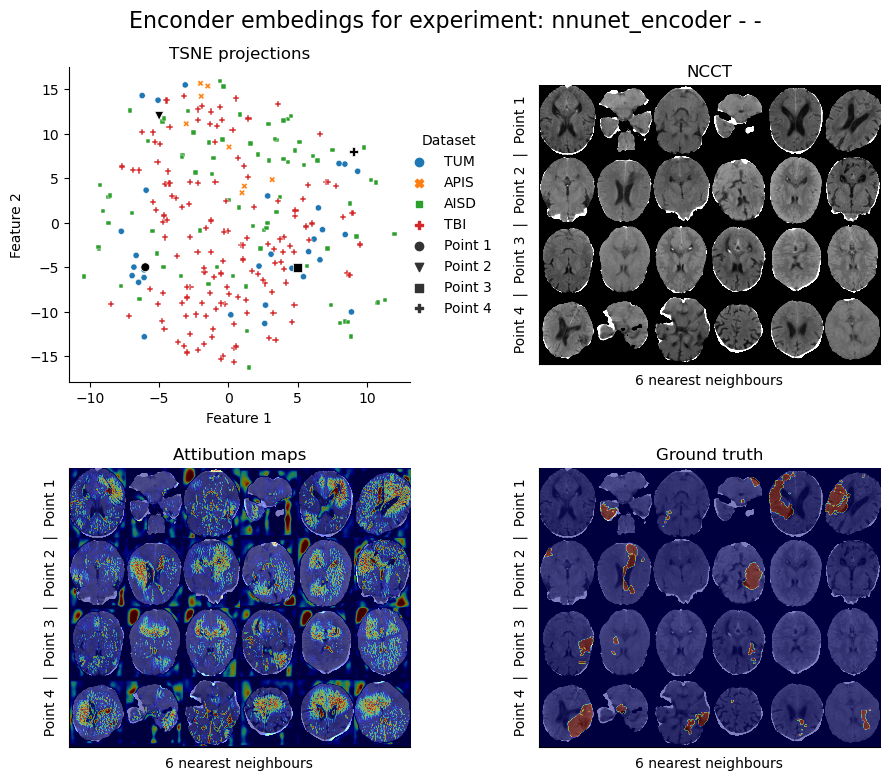

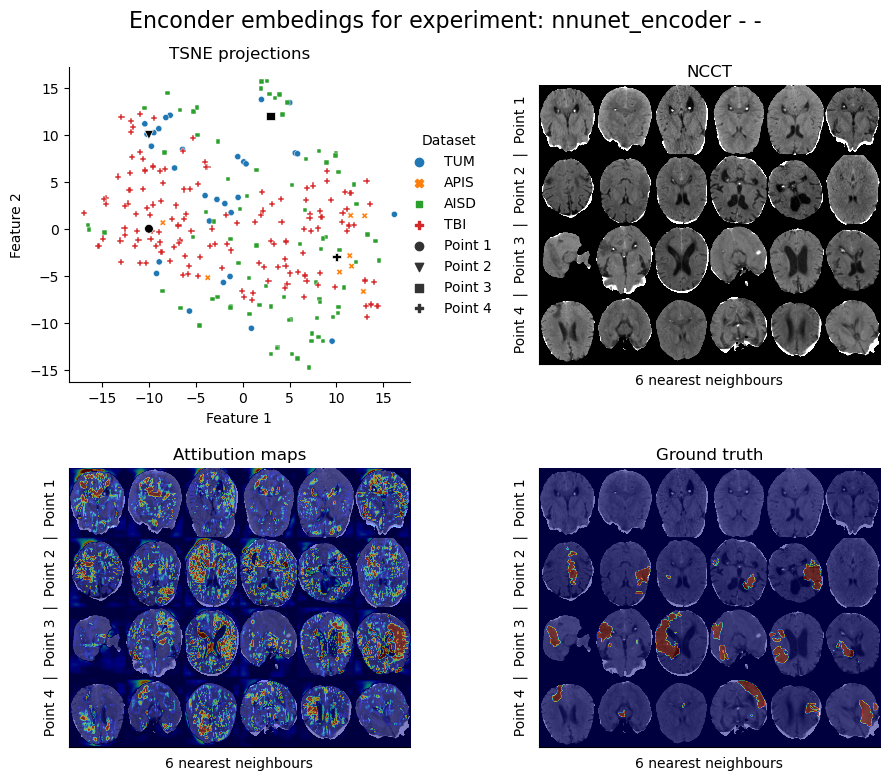

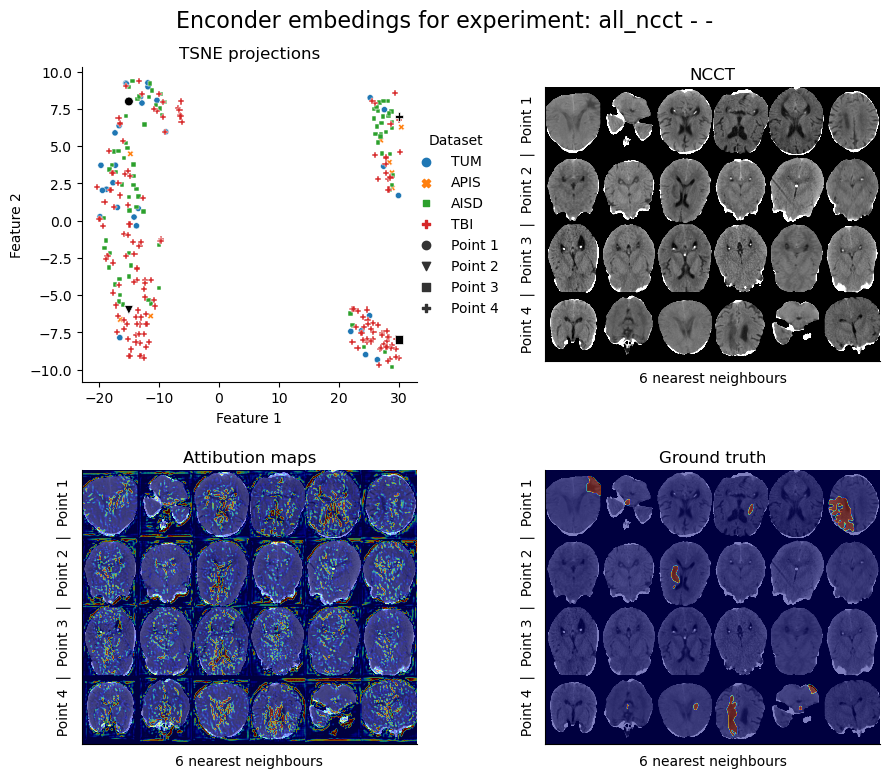

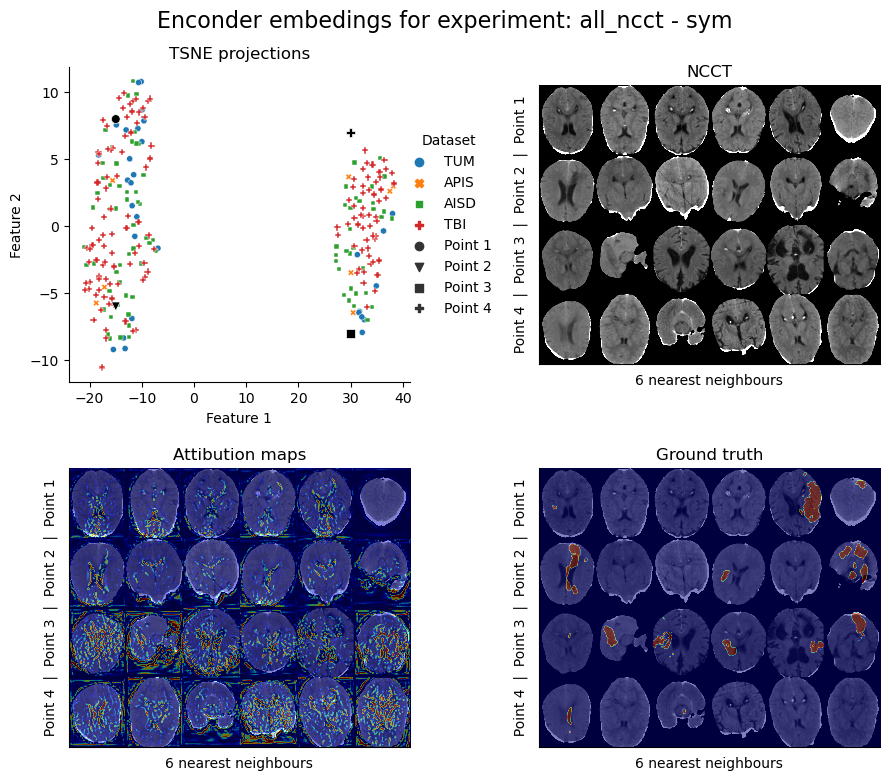

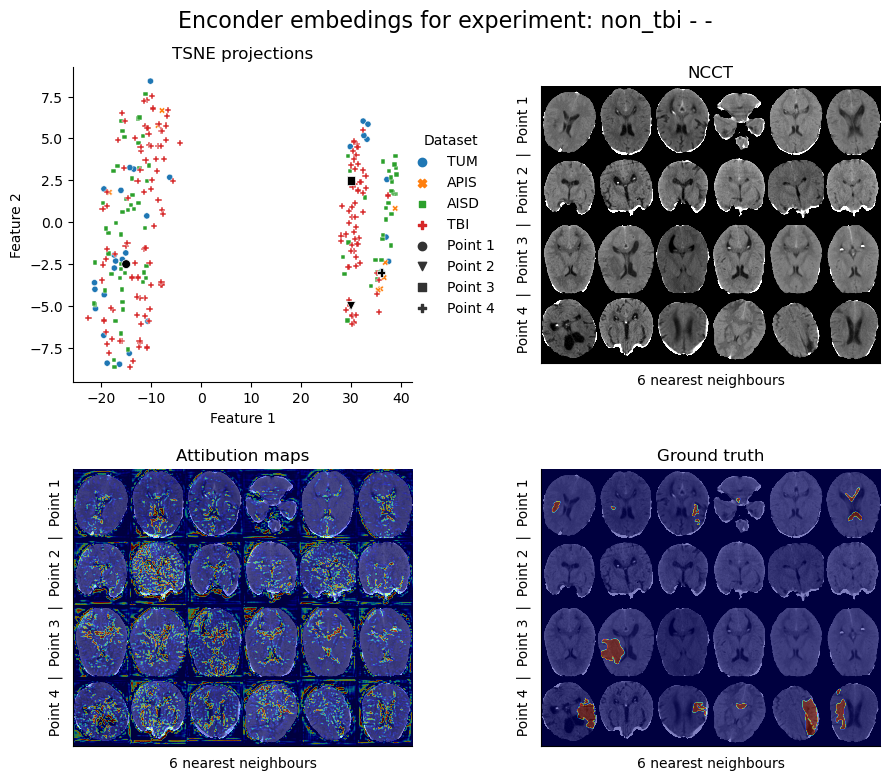

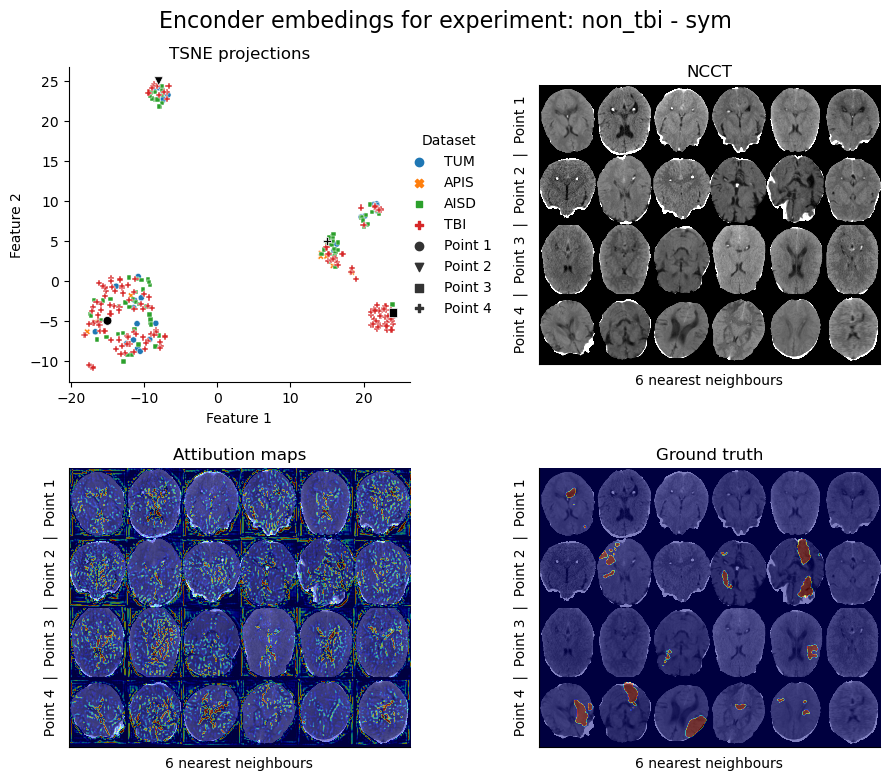

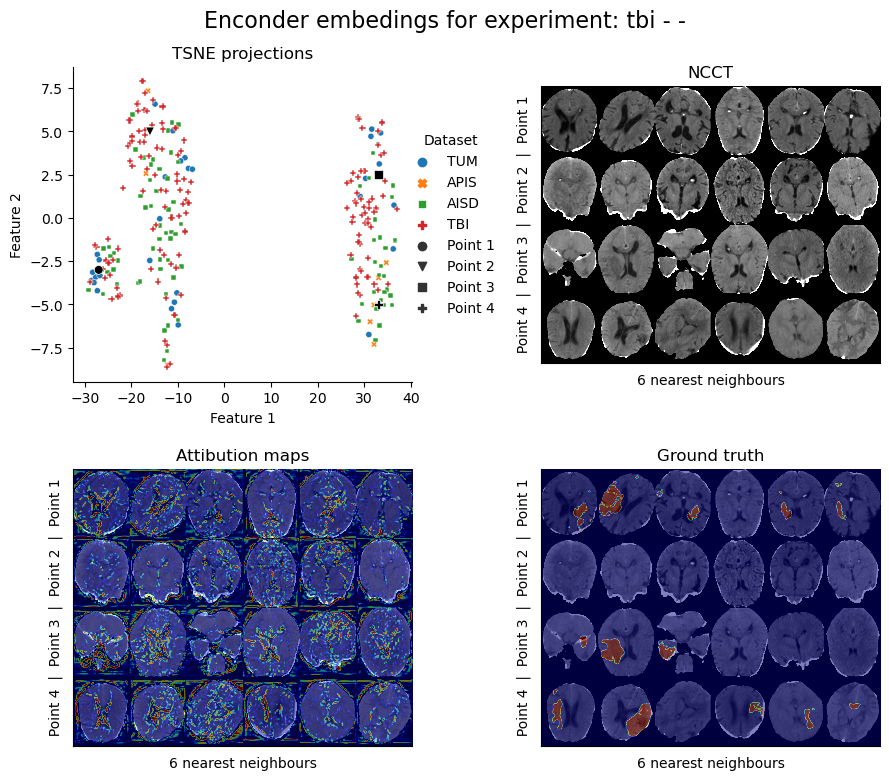

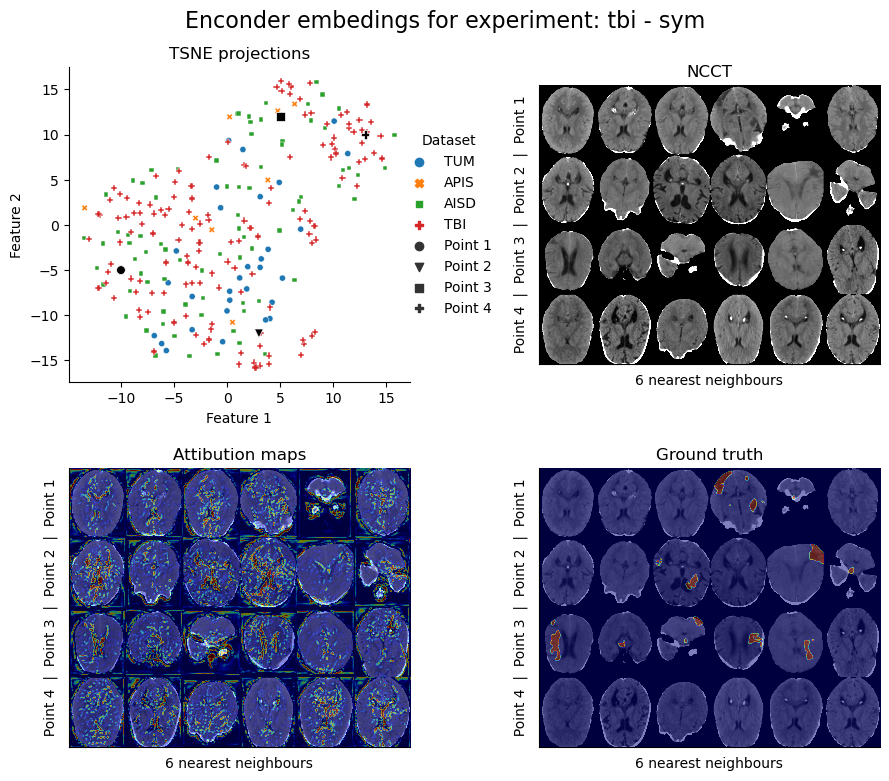

In [6]:
%matplotlib inline
exps_cfgs = [
    {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-',
     'centers': {'tsne': [[-6, -5], [-5, 12], [5, -5], [9, 8]]}},
    {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-',
     'centers': {'tsne': [[-10, 0], [-10, 10], [3, 12], [10, -3]]}},
    {'data': 'all_ncct', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'all_ncct', 'exp': '004', 'context': 'sym',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'non_tbi', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, -2.5], [30, -5], [30, 2.5],[36, -3]]}},
    {'data': 'non_tbi', 'exp': '003', 'context': 'sym',
     'centers': {'tsne': [[-15, -5], [-8,25], [24, -4], [15, 5]]}},
    {'data': 'tbi', 'exp': '000', 'context': '-',
     'centers': {'tsne': [[-27, -3], [-16, 5], [33, 2.5], [33, -5]]}},
    {'data': 'tbi', 'exp': '001', 'context': 'sym',
     'centers': {'tsne': [[-10, -5], [3, -12], [5, 12], [13, 10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=1, slice_criteria='gt'
)

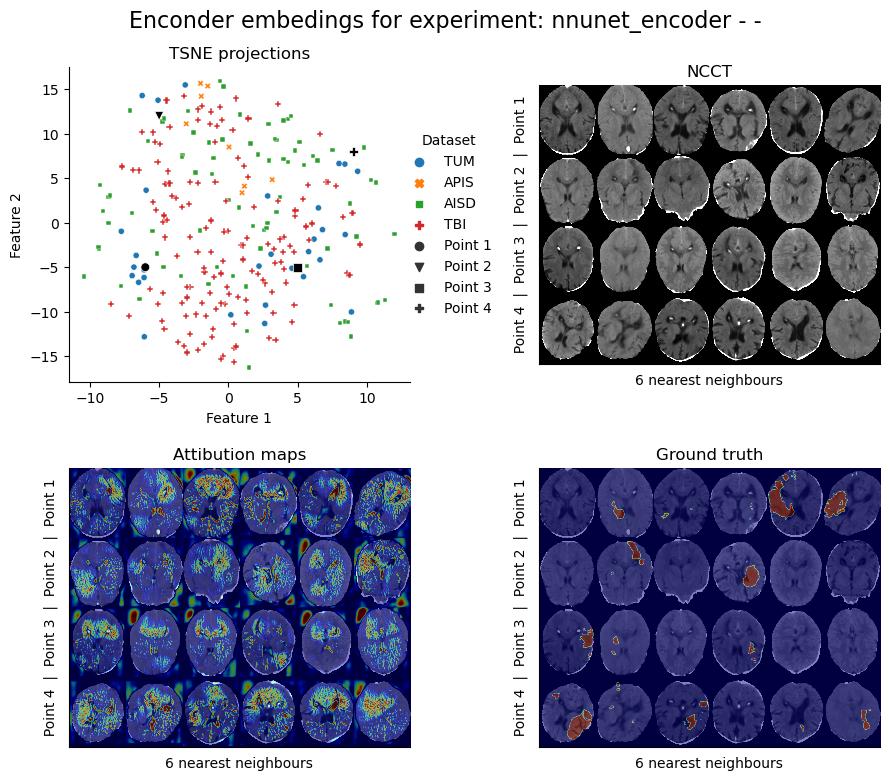

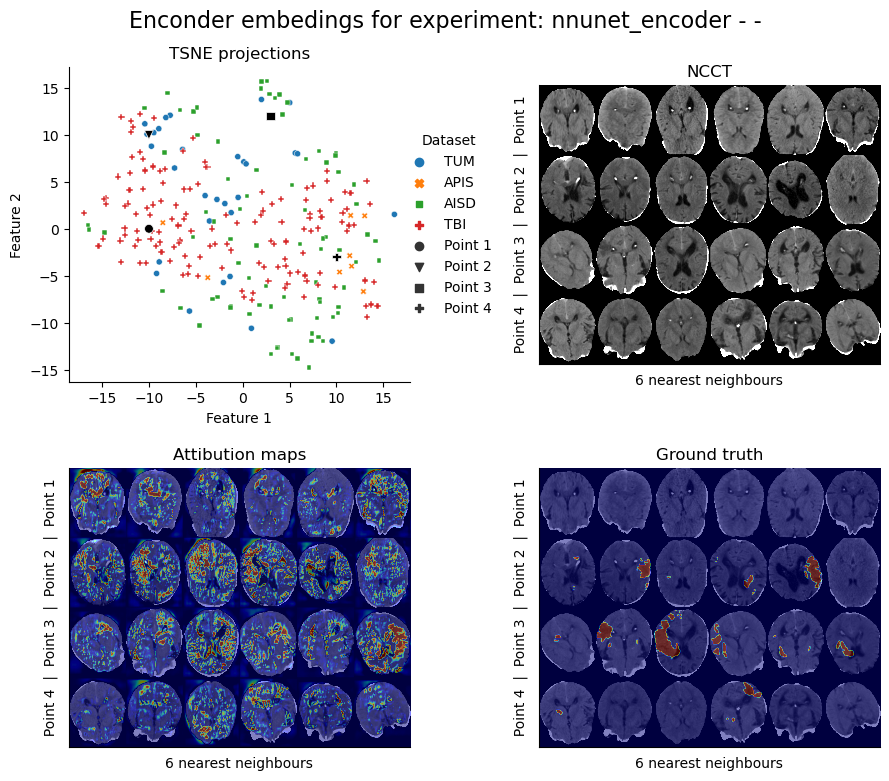

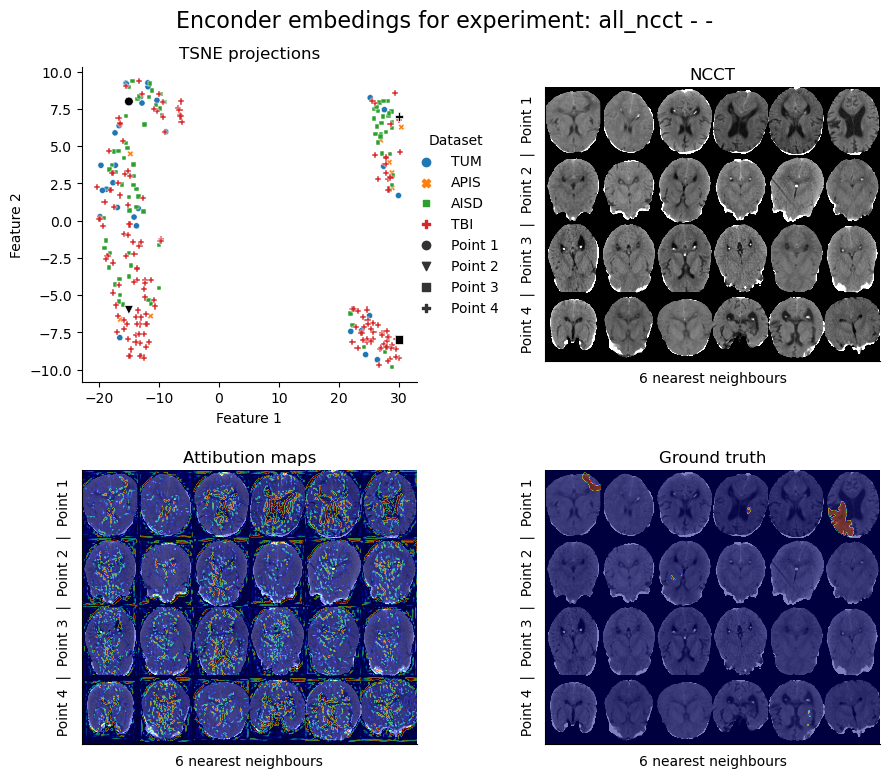

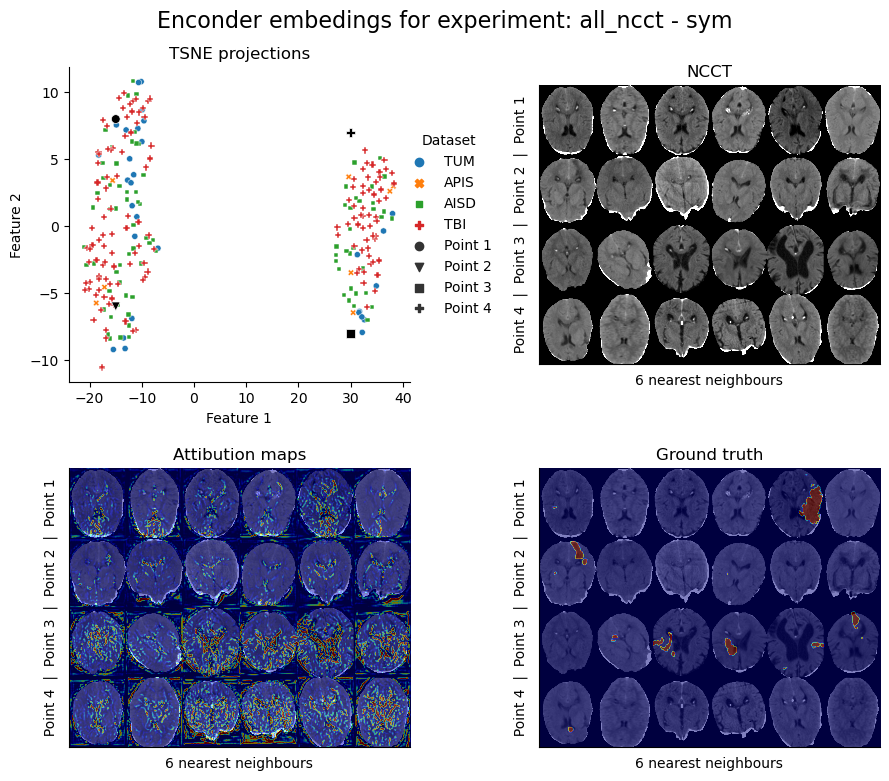

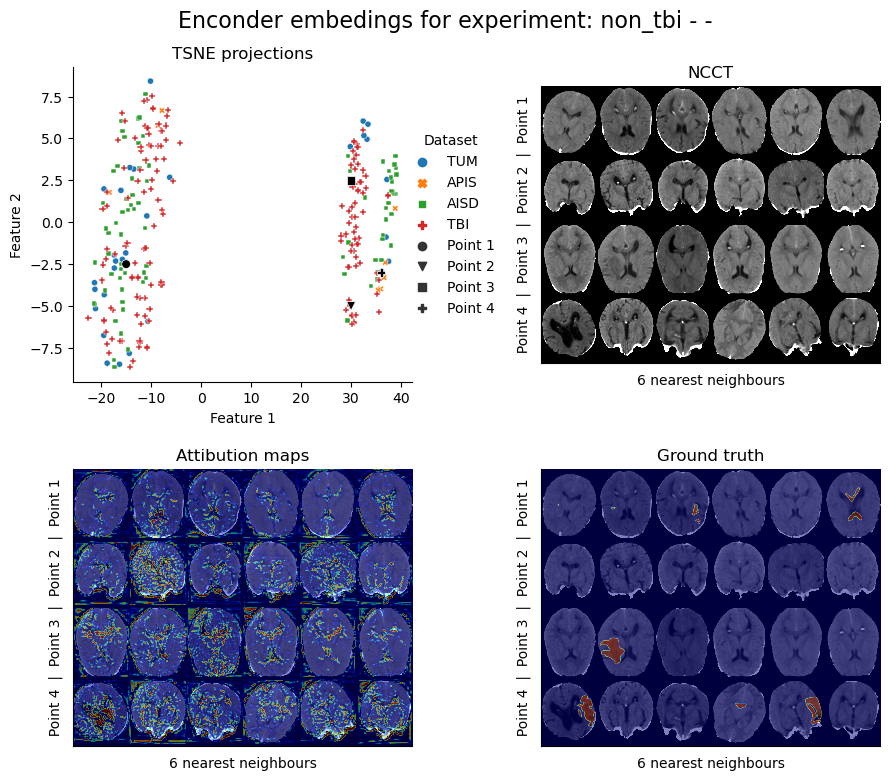

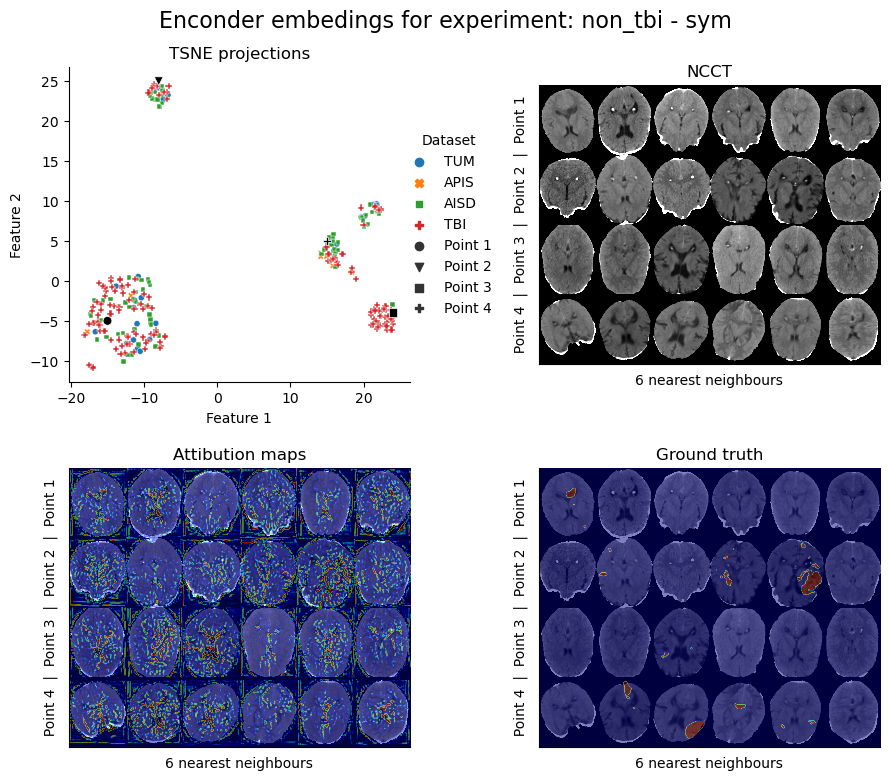

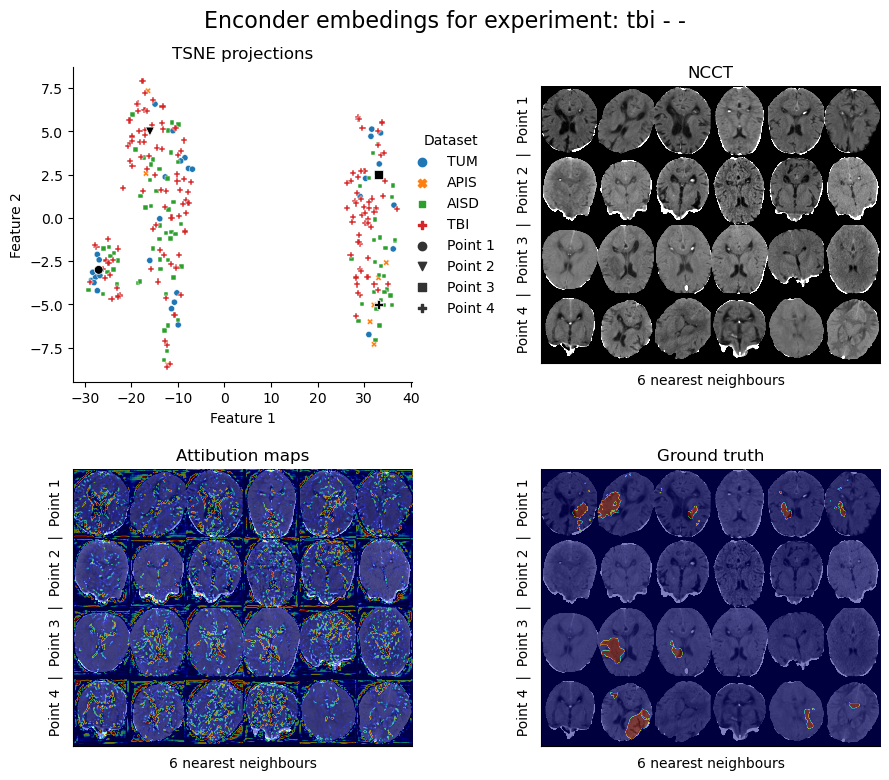

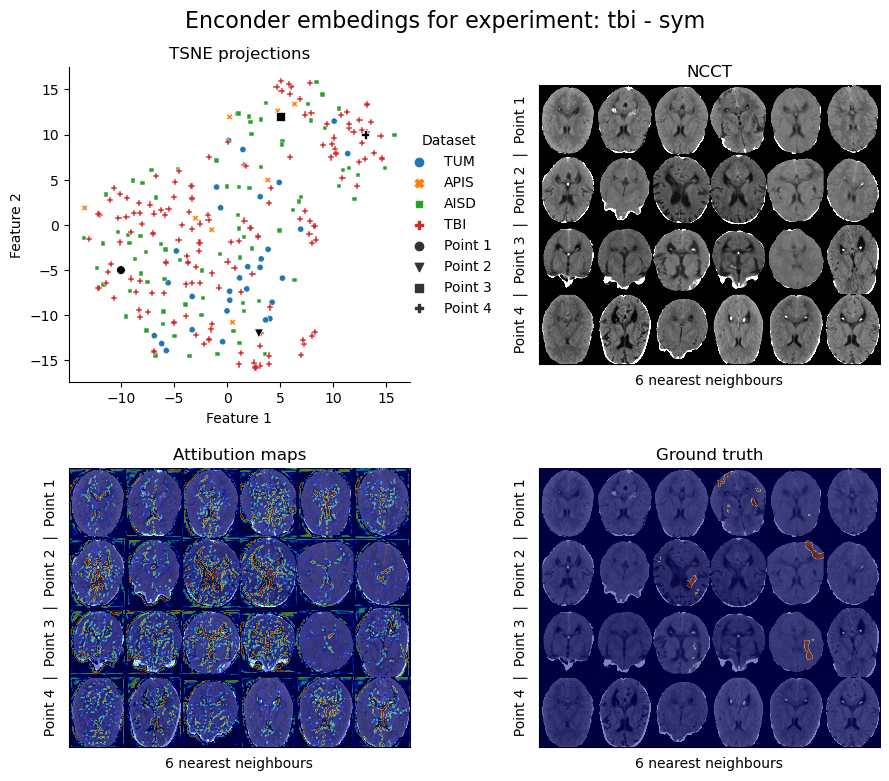

In [7]:
%matplotlib inline
exps_cfgs = [
    {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-',
     'centers': {'tsne': [[-6, -5], [-5, 12], [5, -5], [9, 8]]}},
    {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-',
     'centers': {'tsne': [[-10, 0], [-10, 10], [3, 12], [10, -3]]}},
    {'data': 'all_ncct', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'all_ncct', 'exp': '004', 'context': 'sym',
     'centers': {'tsne': [[-15, 8], [-15, -6], [30, -8], [30, 7]]}},
    {'data': 'non_tbi', 'exp': '001', 'context': '-',
     'centers': {'tsne': [[-15, -2.5], [30, -5], [30, 2.5],[36, -3]]}},
    {'data': 'non_tbi', 'exp': '003', 'context': 'sym',
     'centers': {'tsne': [[-15, -5], [-8,25], [24, -4], [15, 5]]}},
    {'data': 'tbi', 'exp': '000', 'context': '-',
     'centers': {'tsne': [[-27, -3], [-16, 5], [33, 2.5], [33, -5]]}},
    {'data': 'tbi', 'exp': '001', 'context': 'sym',
     'centers': {'tsne': [[-10, -5], [3, -12], [5, 12], [13, 10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=1, slice_criteria='middle'
)

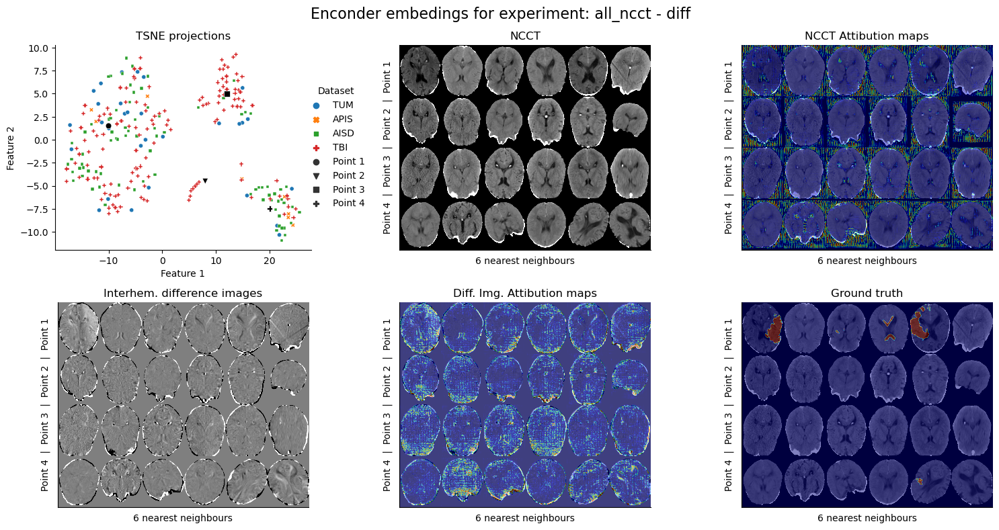

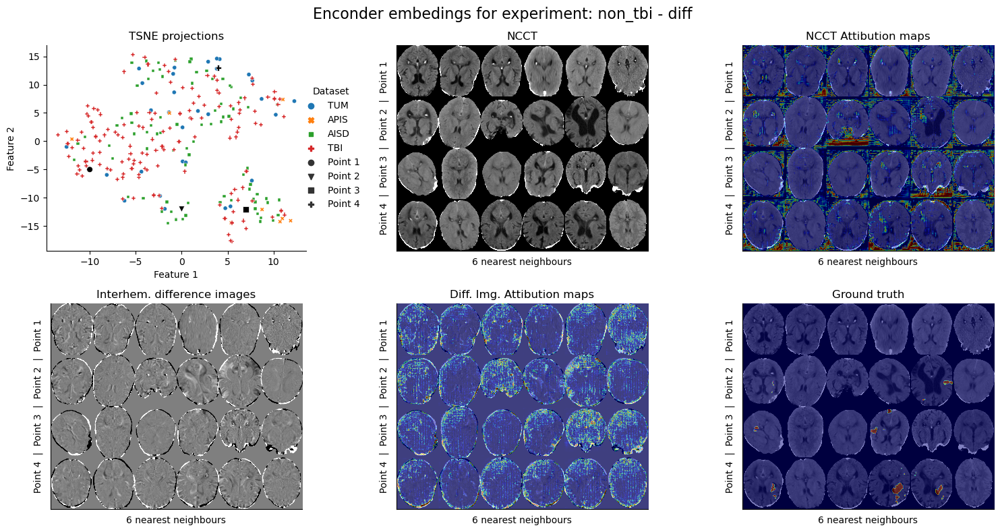

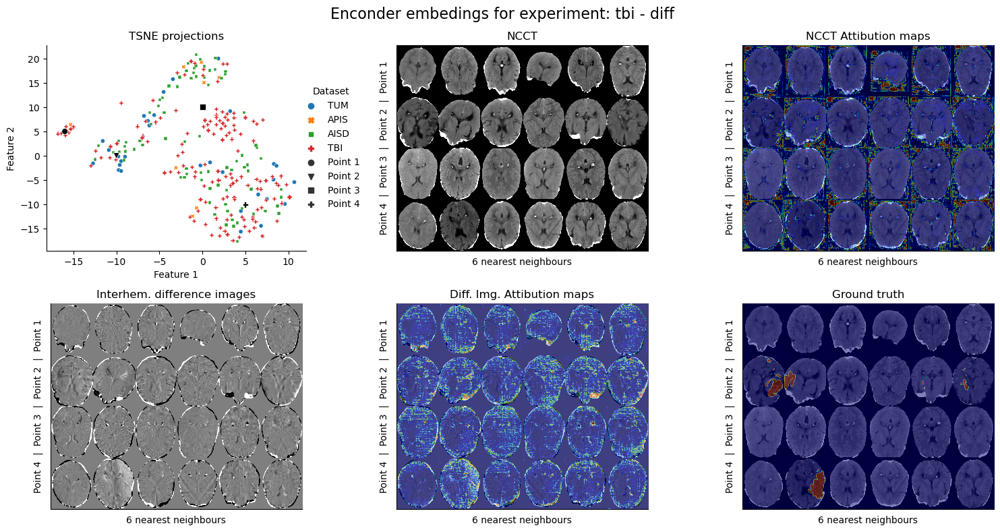

In [8]:
%matplotlib inline
exps_cfgs = [
    {'data': 'all_ncct', 'exp': '002', 'context': 'diff',
     'centers': {'tsne': [[-10, 1.5], [8, -4.5], [12, 5], [20, -7.5]]}},
    {'data': 'non_tbi', 'exp': '004', 'context': 'diff',
     'centers': {'tsne': [[-10, -5], [0,-12], [7, -12], [4, 13]]}},
    {'data': 'tbi', 'exp': '002', 'context': 'diff',
     'centers': {'tsne': [[-16, 5], [-10, 0], [0, 10], [5, -10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=2, slice_criteria='middle'
)

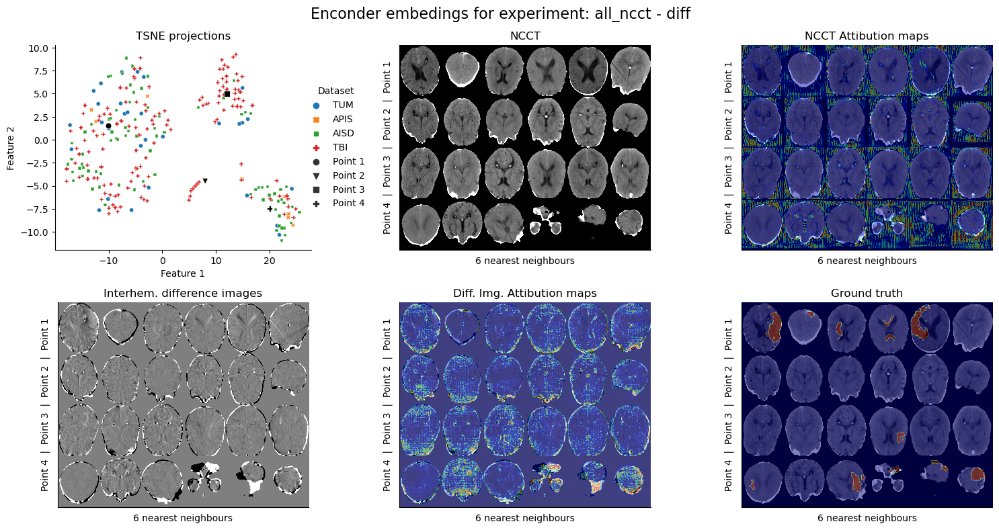

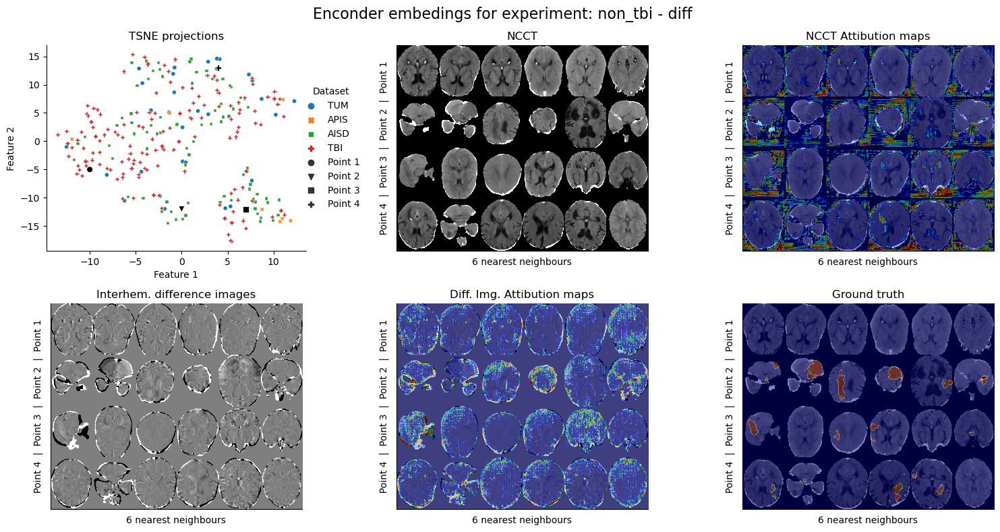

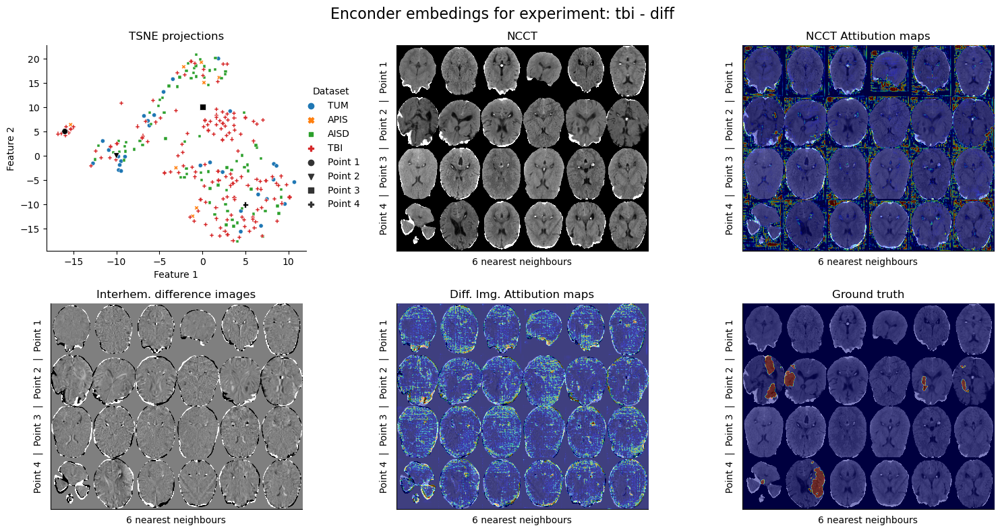

In [9]:
%matplotlib inline
exps_cfgs = [
    {'data': 'all_ncct', 'exp': '002', 'context': 'diff',
     'centers': {'tsne': [[-10, 1.5], [8, -4.5], [12, 5], [20, -7.5]]}},
    {'data': 'non_tbi', 'exp': '004', 'context': 'diff',
     'centers': {'tsne': [[-10, -5], [0,-12], [7, -12], [4, 13]]}},
    {'data': 'tbi', 'exp': '002', 'context': 'diff',
     'centers': {'tsne': [[-16, 5], [-10, 0], [0, 10], [5, -10]]}},
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
gt_path = Path('/home/jseia/Desktop/thesis/code/nnUNet_ais/nnunetv2/preprocessed/Dataset051_AIS/gt_segmentations')
ssl_plots.scatter_examples_method(
    base_cfg_path, base_experiments_path, exps_cfgs, gt_path,
    preproc, lims, 'tsne', plot_type=2, slice_criteria='gt'
)

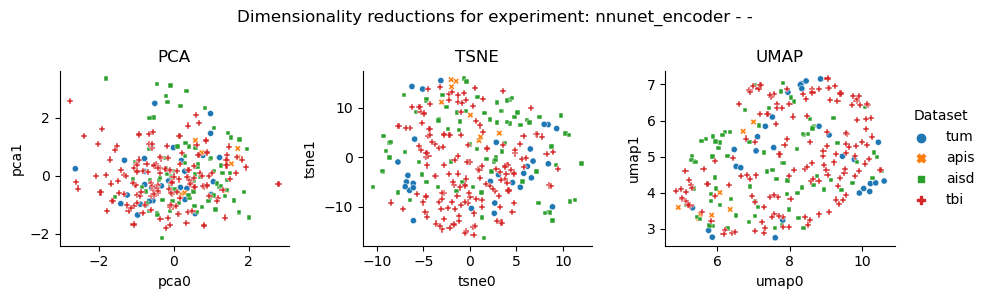

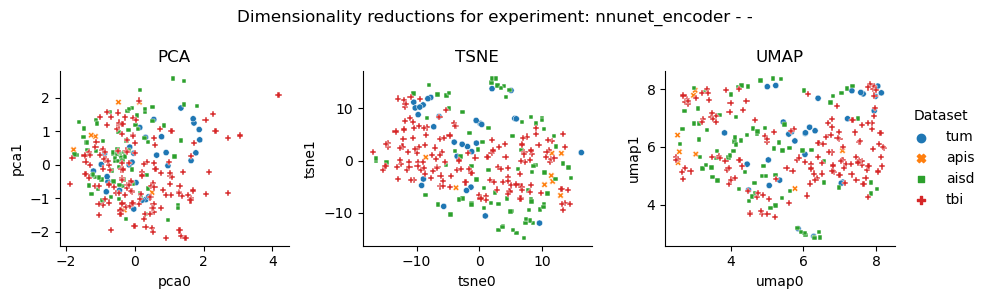

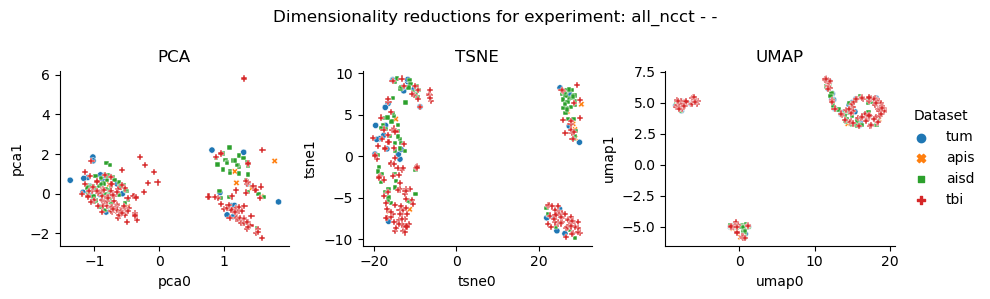

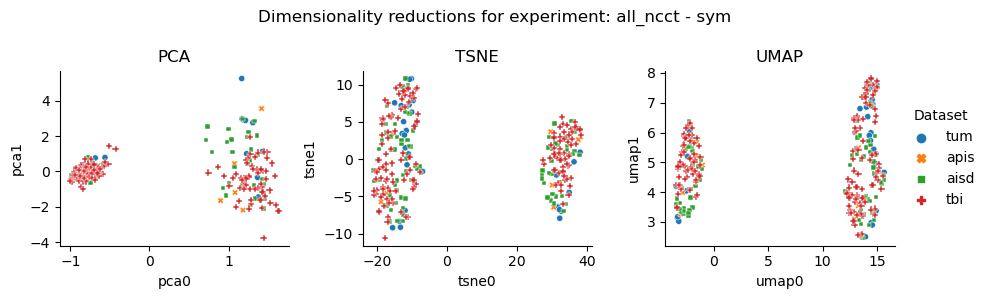

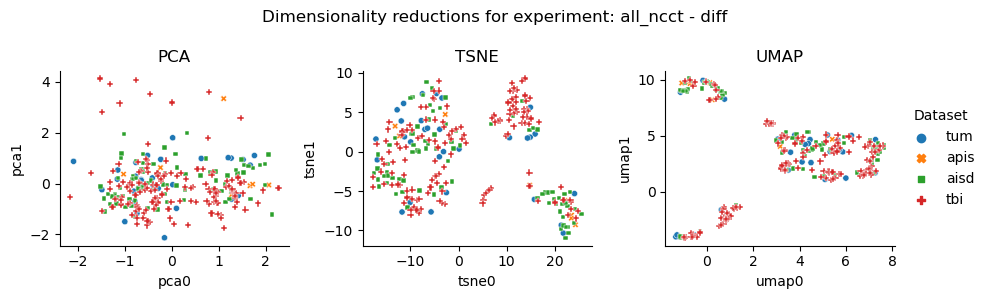

...

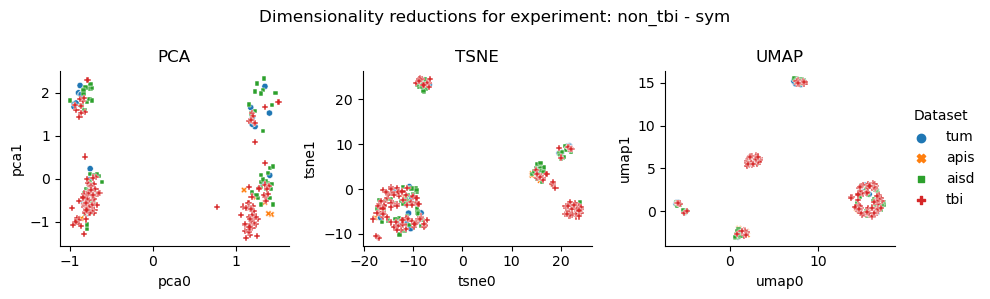

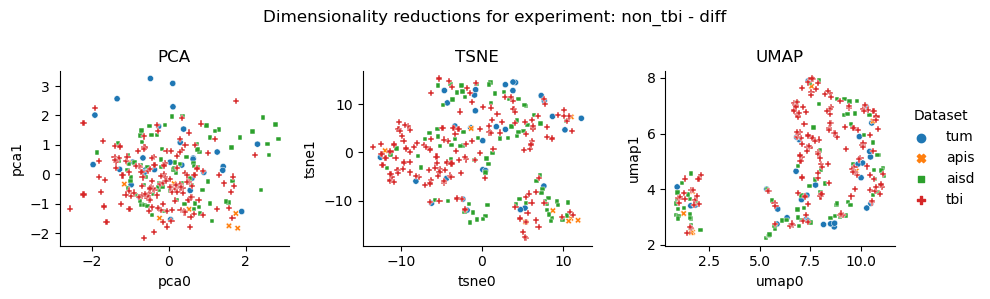

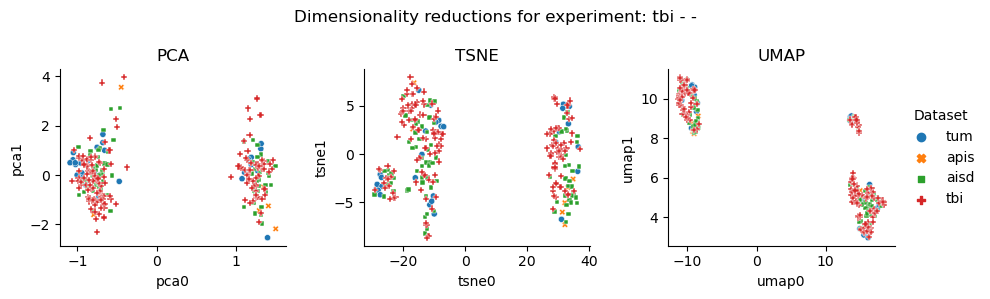

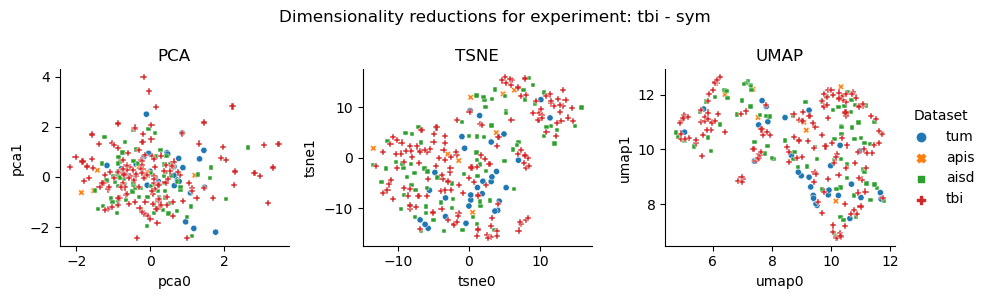

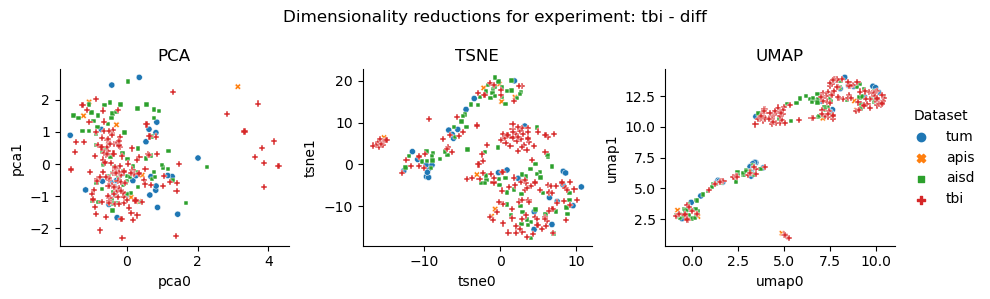

In [10]:
%matplotlib inline
exps_cfgs = [
    {'data': 'nnunet_encoder', 'exp': 'tum', 'context': '-'}, #FS TUM
    {'data': 'nnunet_encoder', 'exp': 'non_tbi', 'context': '-'}, #FS NON-TBI
    {'data': 'all_ncct', 'exp': '001', 'context': '-'}, # No sym 
    {'data': 'all_ncct', 'exp': '004', 'context': 'sym'}, # Sym
    {'data': 'all_ncct', 'exp': '002', 'context': 'diff'}, # Diff
    {'data': 'non_tbi', 'exp': '001', 'context': '-'}, # No sym
    {'data': 'non_tbi', 'exp': '003', 'context': 'sym'}, # Sym
    {'data': 'non_tbi', 'exp': '004', 'context': 'diff'}, # Diff
    {'data': 'tbi', 'exp': '000', 'context': '-'}, # No sym
    {'data': 'tbi', 'exp': '001', 'context': 'sym'}, # Sym
    {'data': 'tbi', 'exp': '002', 'context': 'diff'}, # Diff
]

preproc = False
lims = [-5, 4] if preproc else [0, 80]
ssl_plots.scatter_examples_full(base_experiments_path, base_cfg_path, exps_cfgs, preproc, lims)